In [179]:
# import packages
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import time
import nltk

In [243]:
df = pd.read_csv('/Users/wanghan/Documents/ads-spring2023-project1-wangyeye66/data/philosophy_data.csv')
df.head()

,title,author,school,sentence_spacy,sentence_str,original_publication_date,corpus_edition_date,sentence_length,sentence_lowered,tokenized_txt,lemmatized_str
0,Plato - Complete Works,Plato,plato,"What's new, Socrates, to make you leave your ...","What's new, Socrates, to make you leave your ...",-350,1997,125,"what's new, socrates, to make you leave your ...","['what', 'new', 'socrates', 'to', 'make', 'you...","what be new , Socrates , to make -PRON- lea..."
1,Plato - Complete Works,Plato,plato,Surely you are not prosecuting anyone before t...,Surely you are not prosecuting anyone before t...,-350,1997,69,surely you are not prosecuting anyone before t...,"['surely', 'you', 'are', 'not', 'prosecuting',...",surely -PRON- be not prosecute anyone before ...
2,Plato - Complete Works,Plato,plato,The Athenians do not call this a prosecution b...,The Athenians do not call this a prosecution b...,-350,1997,74,the athenians do not call this a prosecution b...,"['the', 'athenians', 'do', 'not', 'call', 'thi...",the Athenians do not call this a prosecution ...
3,Plato - Complete Works,Plato,plato,What is this you say?,What is this you say?,-350,1997,21,what is this you say?,"['what', 'is', 'this', 'you', 'say']",what be this -PRON- say ?
4,Plato - Complete Works,Plato,plato,"Someone must have indicted you, for you are no...","Someone must have indicted you, for you are no...",-350,1997,101,"someone must have indicted you, for you are no...","['someone', 'must', 'have', 'indicted', 'you',...","someone must have indict -PRON- , for -PRON- ..."


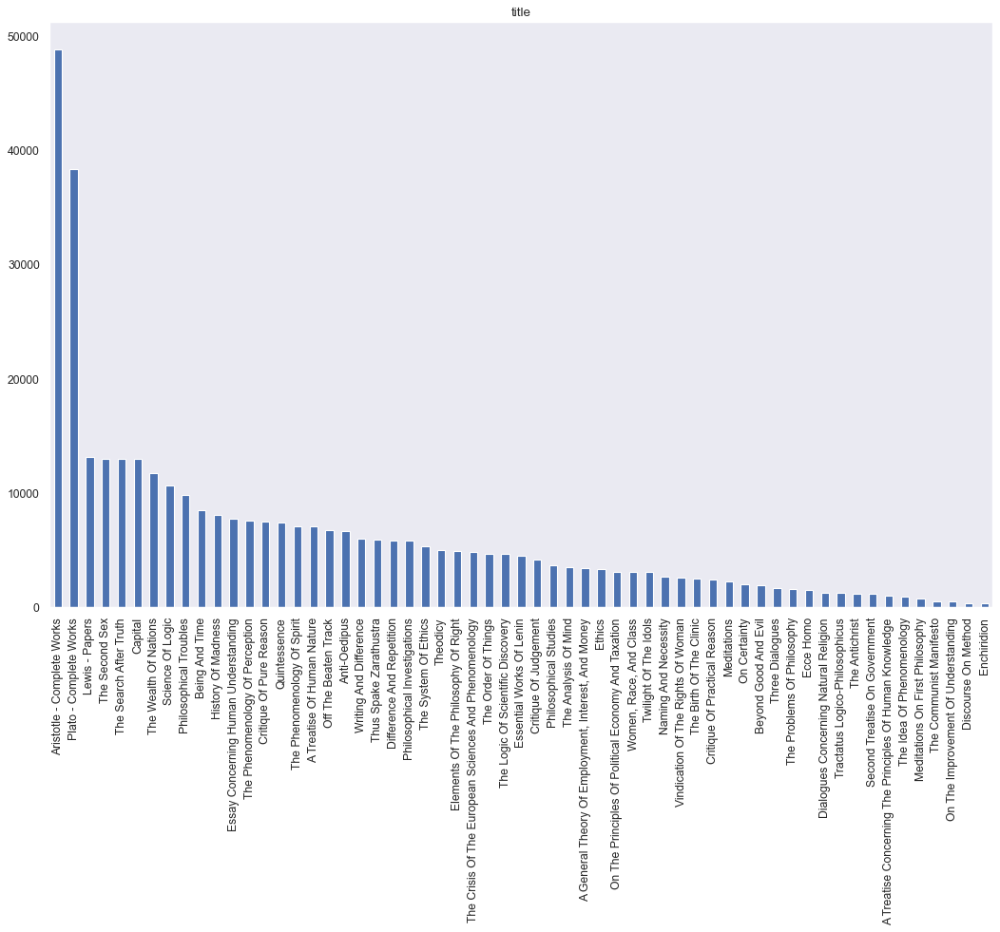

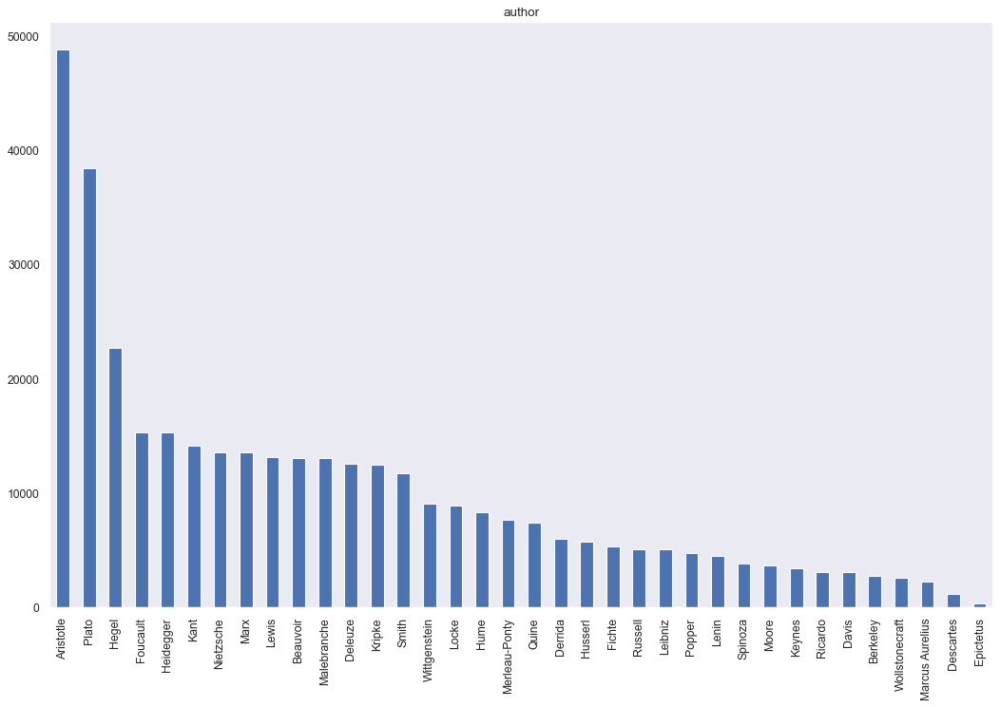

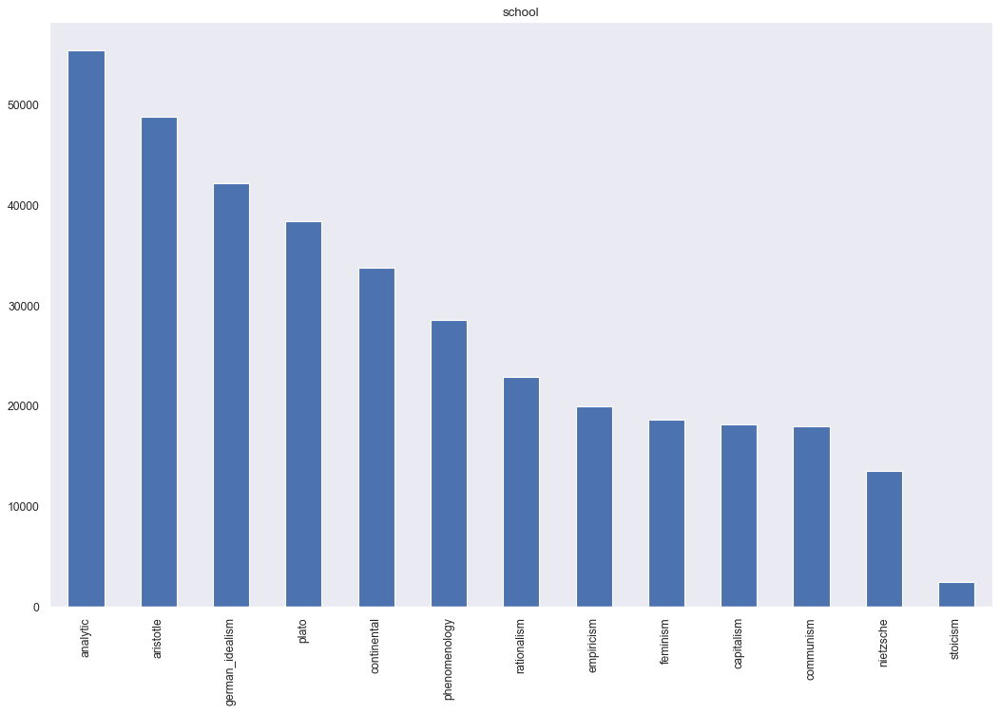

In [181]:
# categorical data distributions
features = ['title', 'author', 'school']
for f in features:
    plt.figure(figsize=(16,10), dpi = 80)
    df[f].value_counts().plot(kind = 'bar')
    plt.title(f)
    plt.grid()
    plt.show()

count    360808.000000
mean        150.790964
std         104.822072
min          20.000000
25%          75.000000
50%         127.000000
75%         199.000000
max        2649.000000
Name: sentence_length, dtype: float64


Text(-8.805555555555555, 0.5, 'Counts')

<Figure size 1200x500 with 0 Axes>

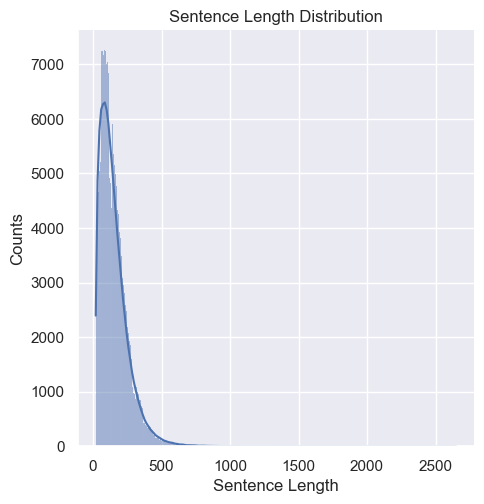

<Figure size 1200x500 with 0 Axes>

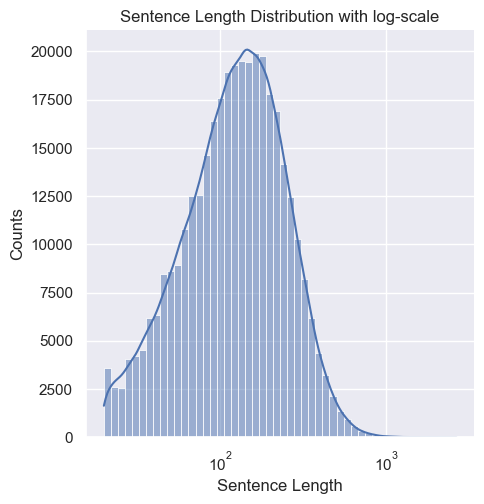

In [182]:
# show distributions of numerical data before moving forward
print(df.sentence_length.describe())
plt.figure(figsize=(12,5))
sns.displot(df['sentence_length'], kde =True)
plt.title('Sentence Length Distribution')
plt.xlabel('Sentence Length')
plt.ylabel('Counts')
# plt.savefig('sentence_length_dist.png', format='png', dpi=80, bbox_inches='tight')


# looks like a normal distribution
plt.figure(figsize=(12,5))
sns.displot(df['sentence_length'],log_scale = True, kde= True, bins=50)
plt.title('Sentence Length Distribution with log-scale')
plt.xlabel('Sentence Length')
plt.ylabel('Counts')
# plt.savefig('sentence_length_dist_log.png', format='png', dpi=80, bbox_inches='tight')



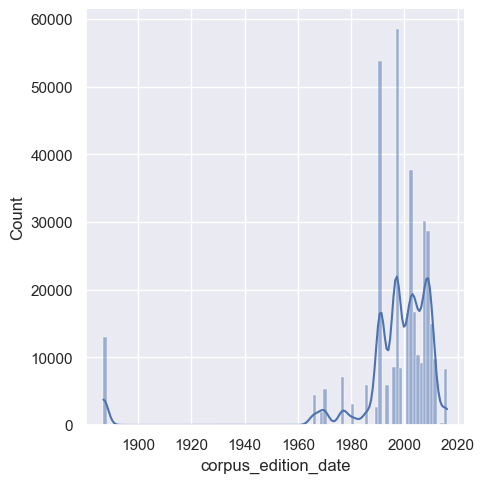

In [183]:
# corpus edition date cluster around year 1990~2010
sns.displot(df['corpus_edition_date'],kde = True, bins = 100)

Text(0.5, 0, 'Length')

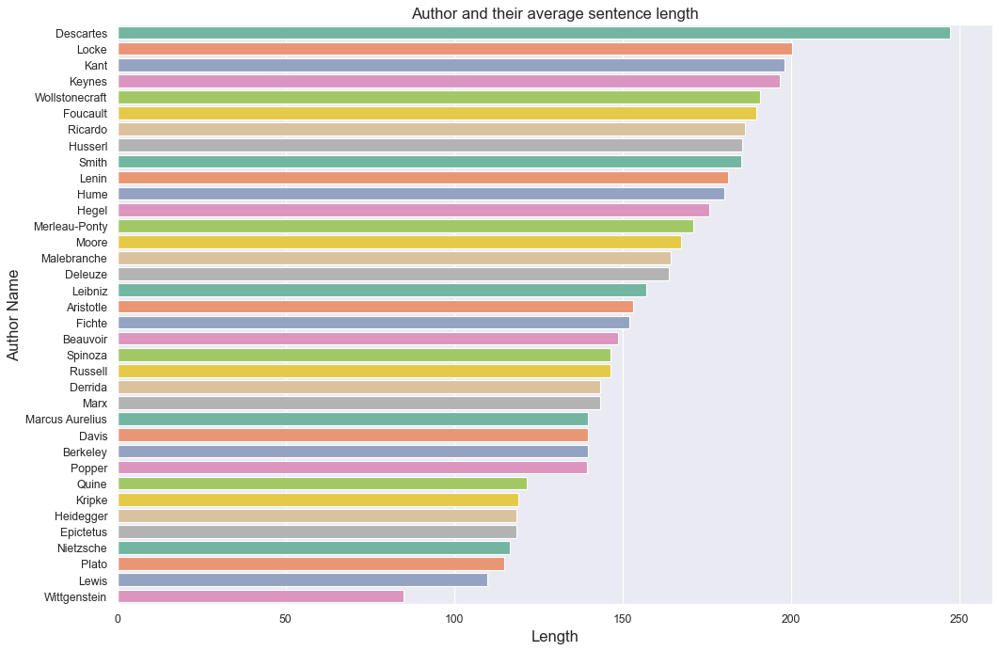

In [184]:
# sentence length comparison over authors
avg_len = df['sentence_length'].groupby(df['author']).mean()
avg_len_df = pd.DataFrame({'author': avg_len.index, 'length':avg_len.values})
avg_len_df = avg_len_df.sort_values(by = ['length'], ascending = False)
avg_len_df

plt.figure(figsize=(15,10), dpi = 80)
ax = sns.barplot(x = 'length',
                 y = 'author', 
                 palette = 'Set2',
                 data = avg_len_df)
ax.set_title('Author and their average sentence length', fontsize=15)
ax.set_ylabel('Author Name', fontsize=15)
ax.set_xlabel('Length', fontsize=15)


Text(0, 0.5, 'Schools')

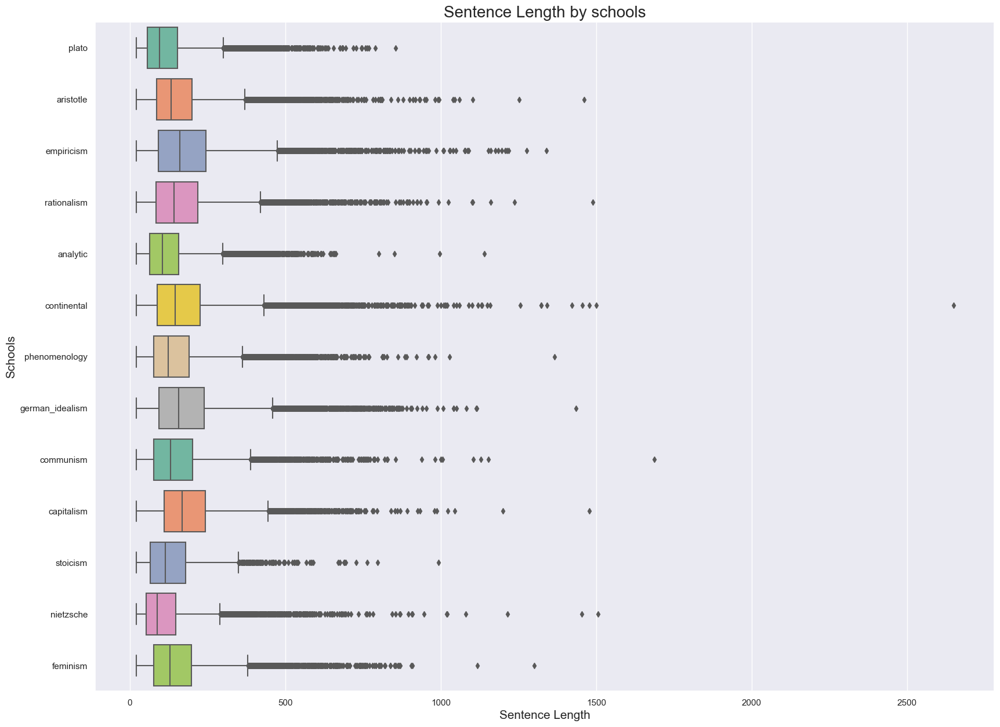

In [185]:

plt.figure(figsize=(20,15))
sns.boxplot(y ='school', 
            x = 'sentence_length',
            palette = 'Set2', 
            data = df)
plt.title('Sentence Length by schools', fontsize = 20)
plt.xlabel('Sentence Length',fontsize=15)
plt.ylabel('Schools',fontsize=15)



School =  PLATO :


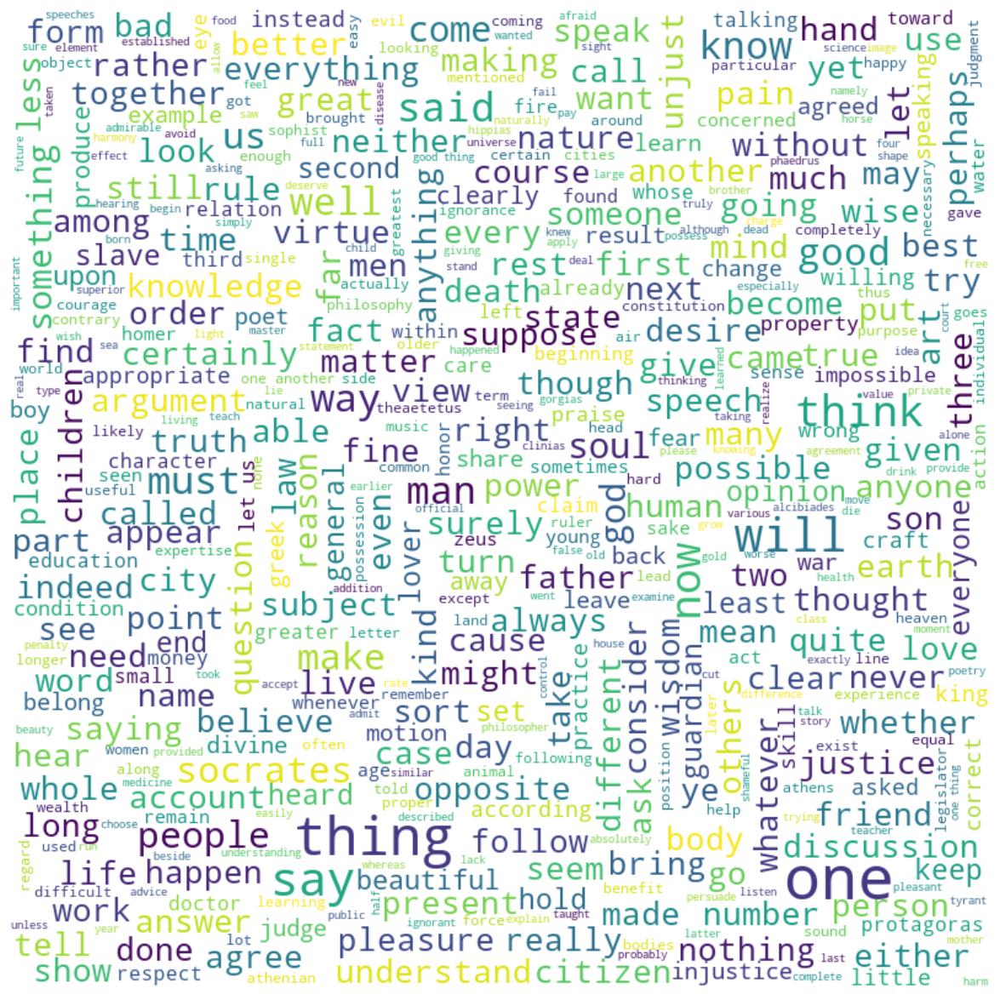

School =  ARISTOTLE :


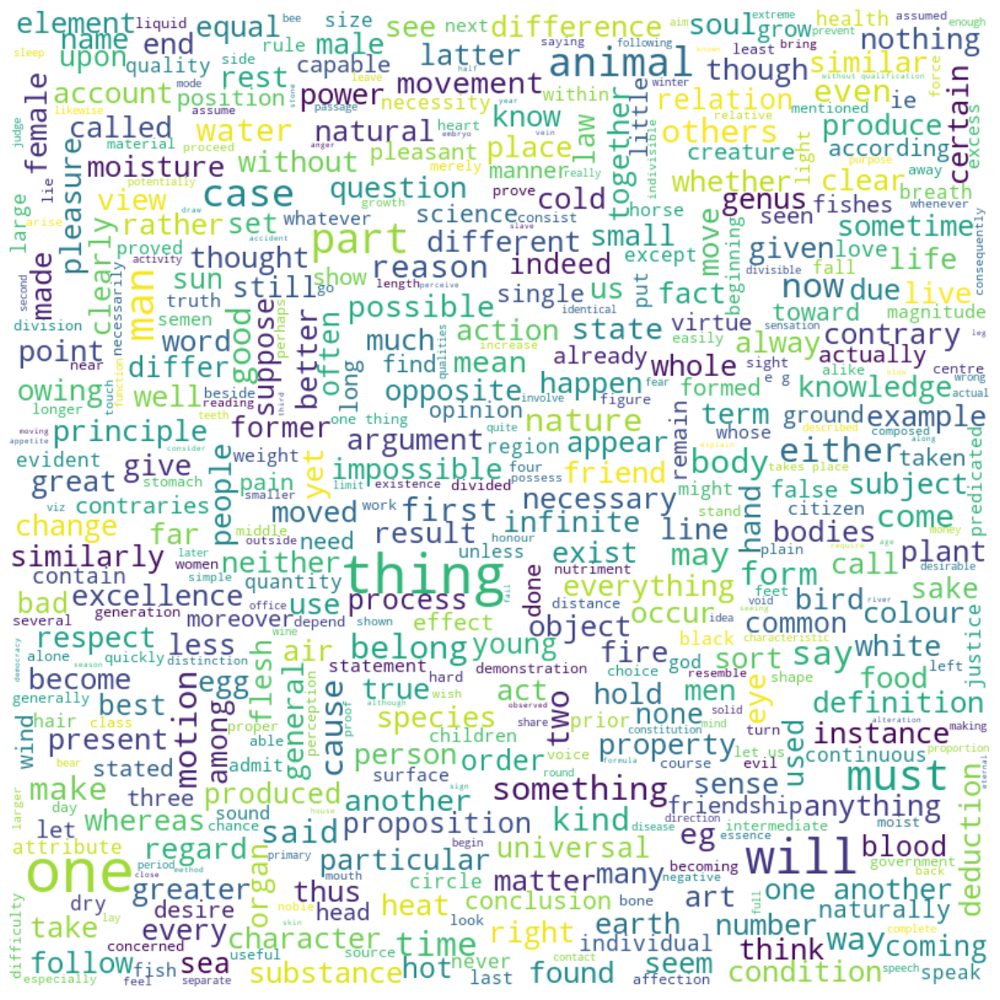

School =  EMPIRICISM :


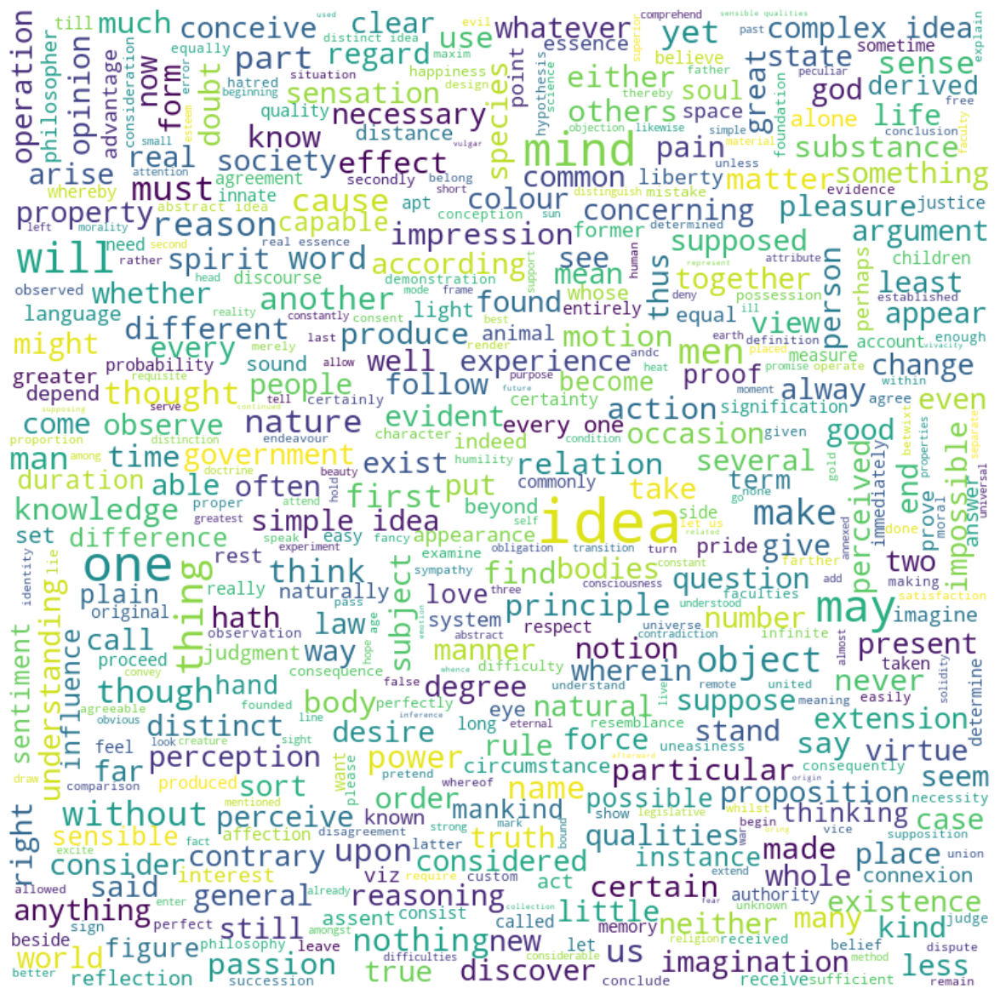

School =  RATIONALISM :


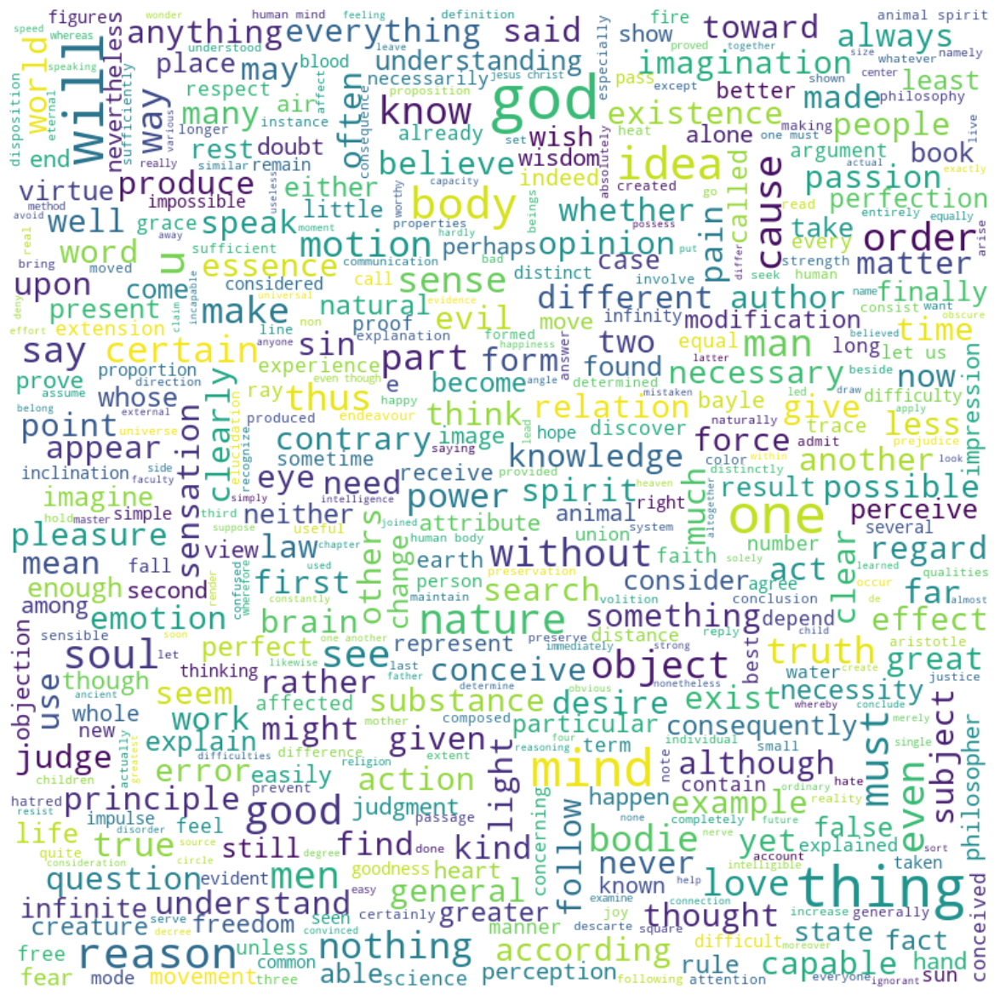

School =  ANALYTIC :


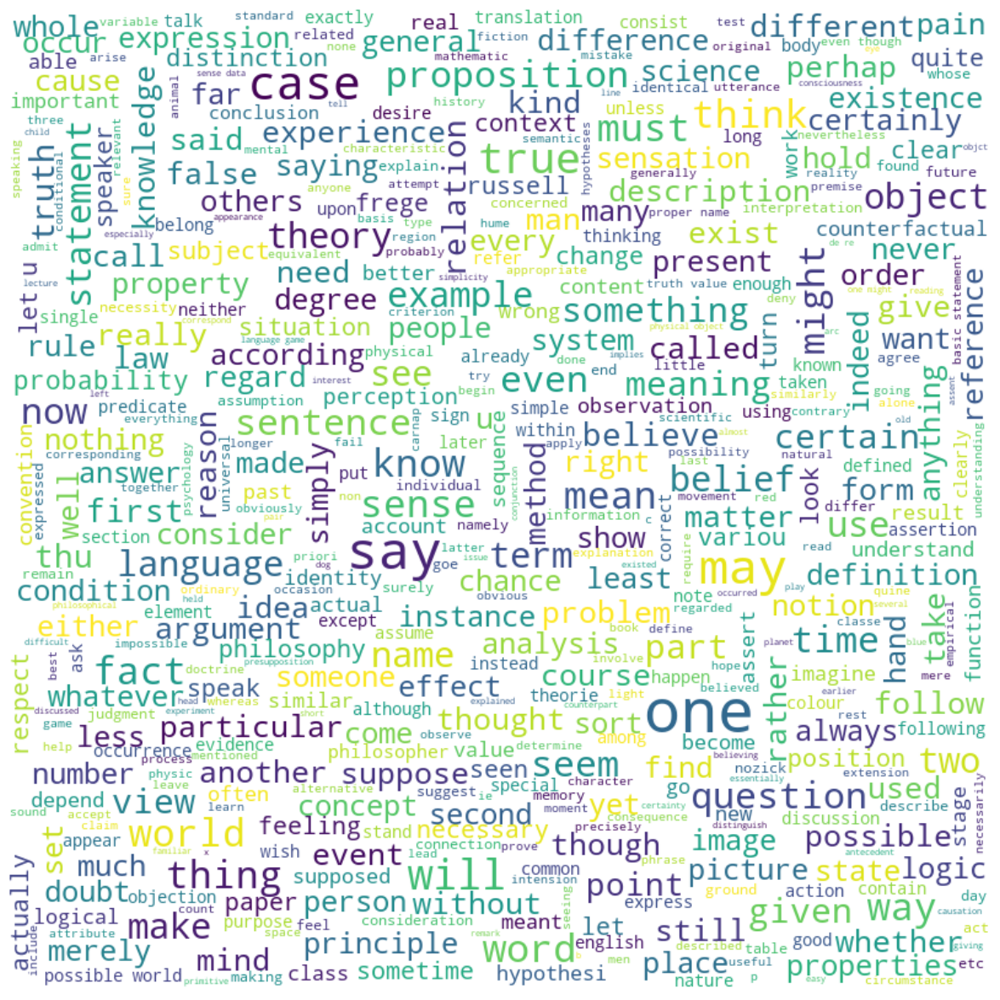

School =  CONTINENTAL :


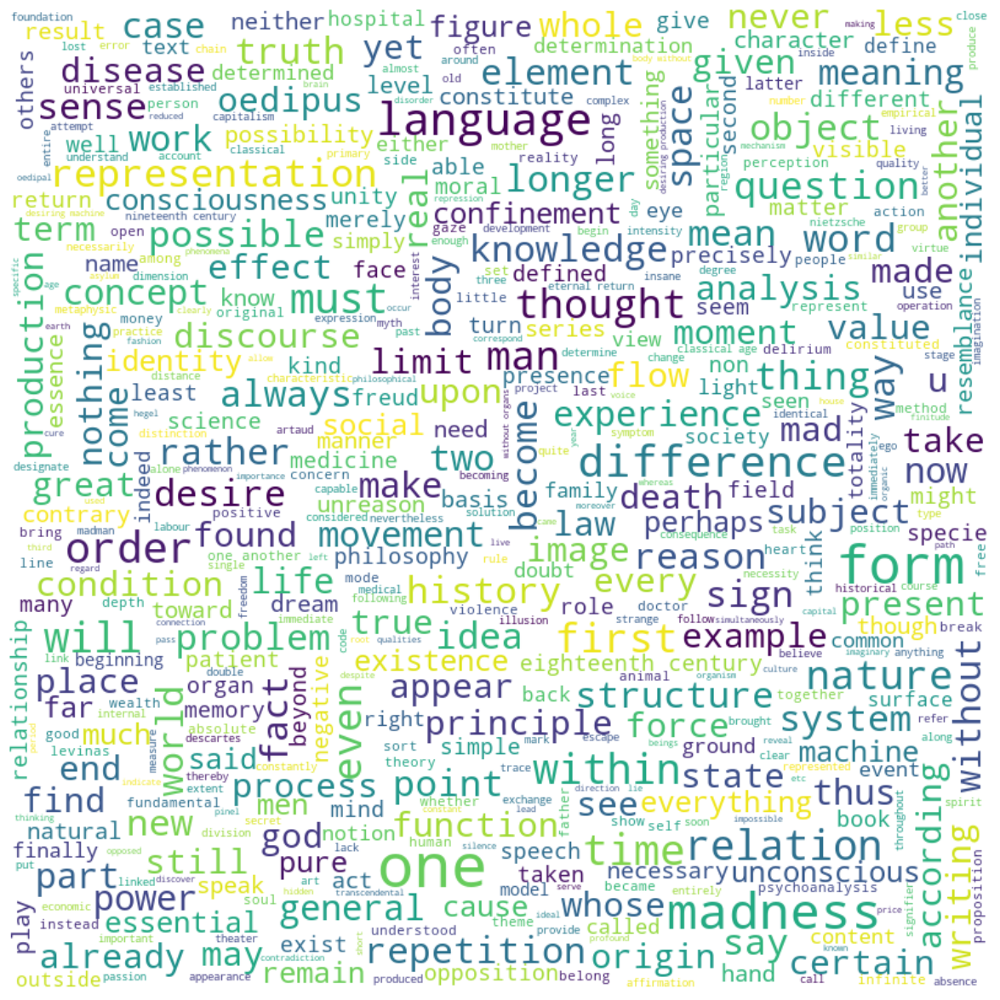

School =  PHENOMENOLOGY :


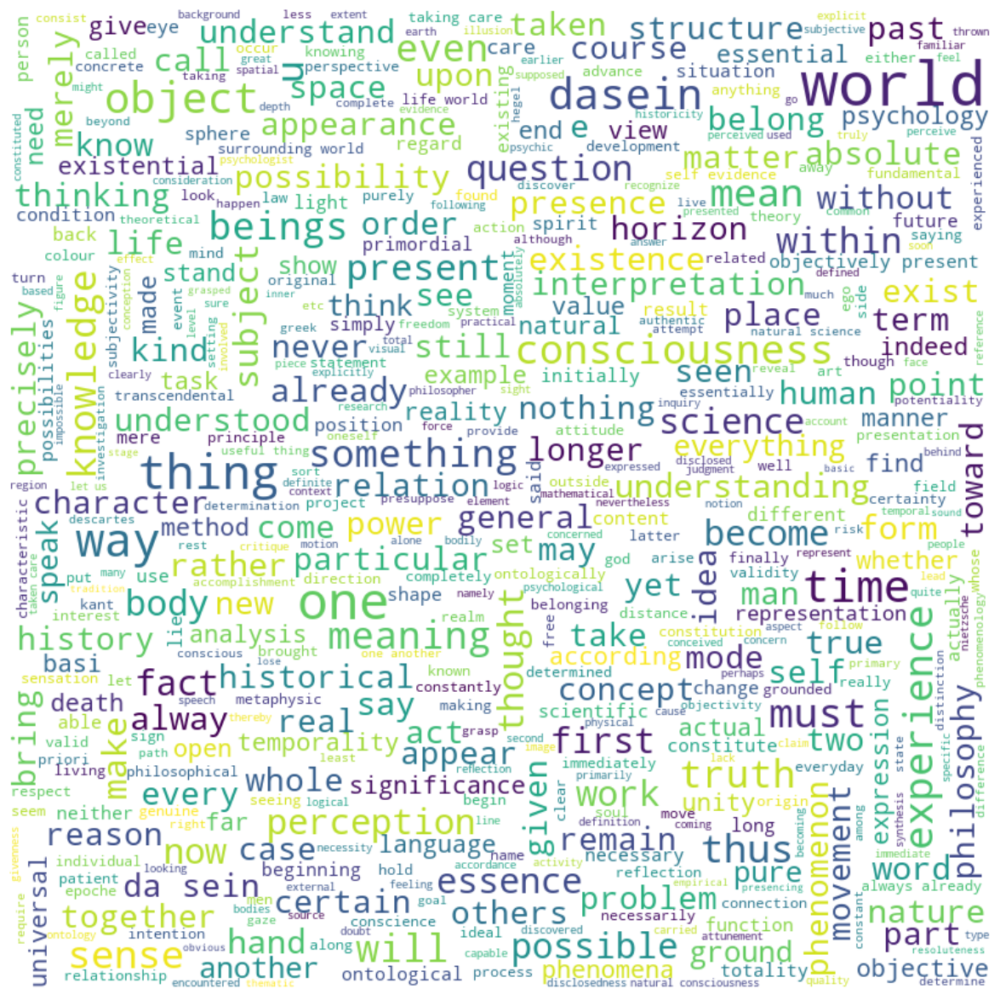

School =  GERMAN_IDEALISM :


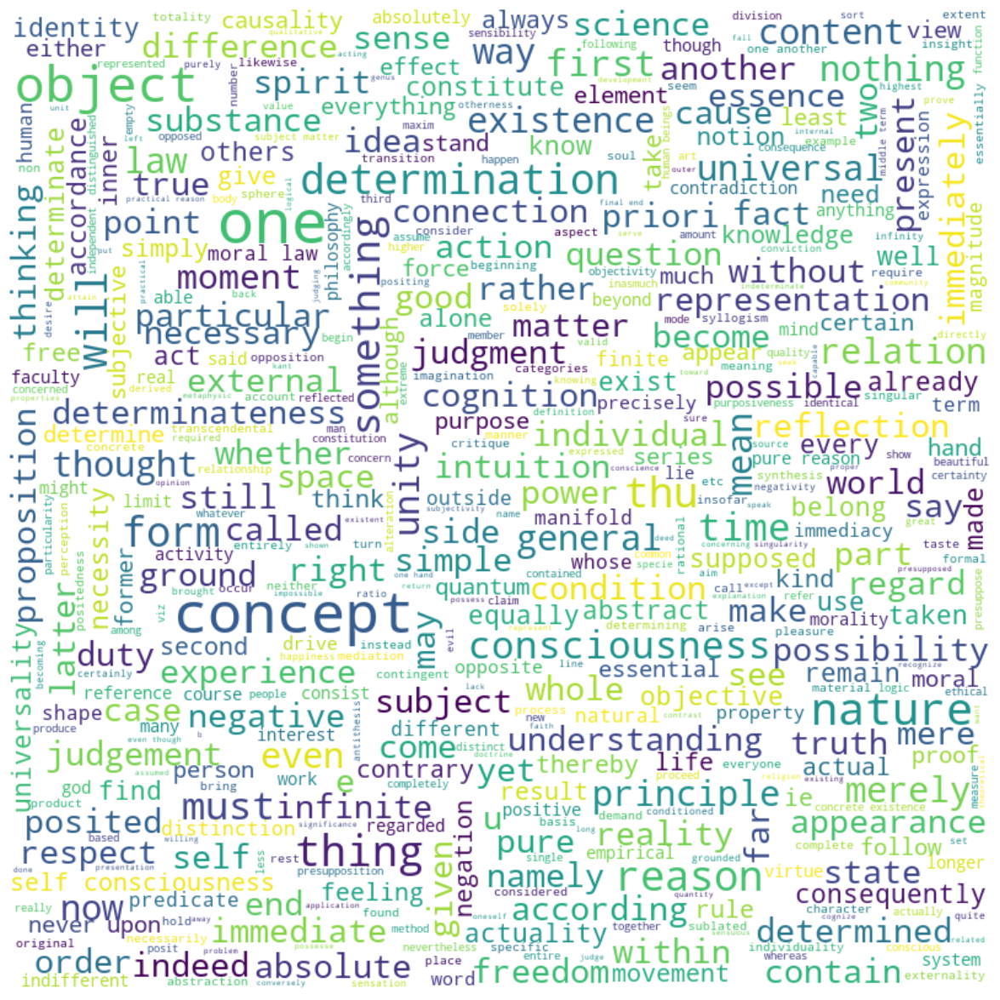

School =  COMMUNISM :


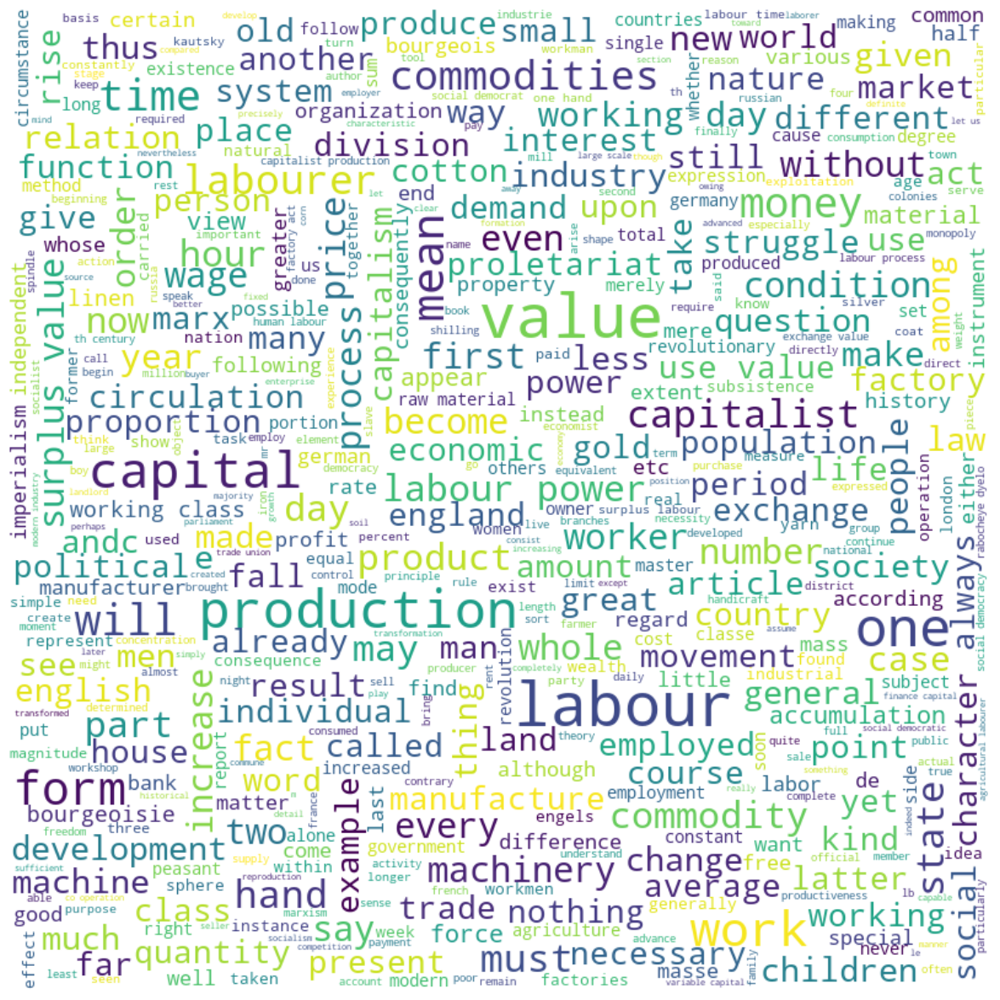

School =  CAPITALISM :


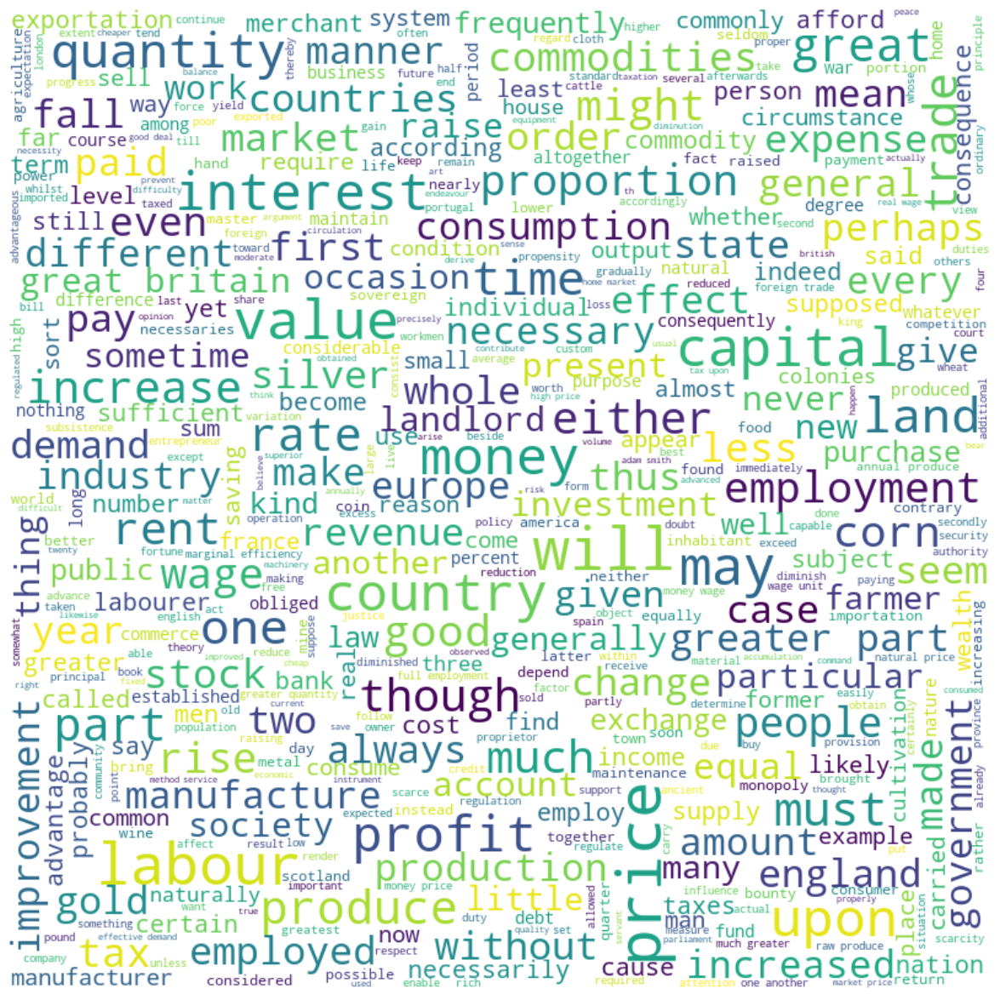

School =  STOICISM :


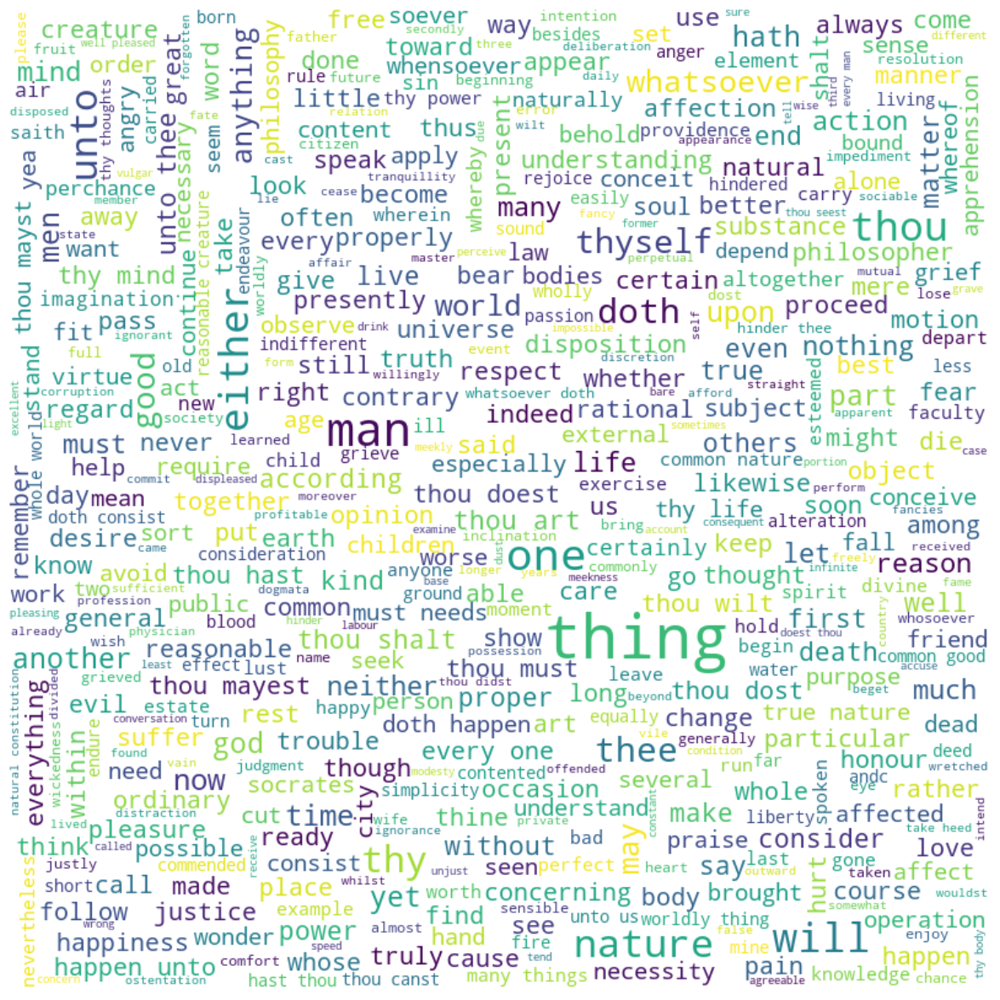

School =  NIETZSCHE :


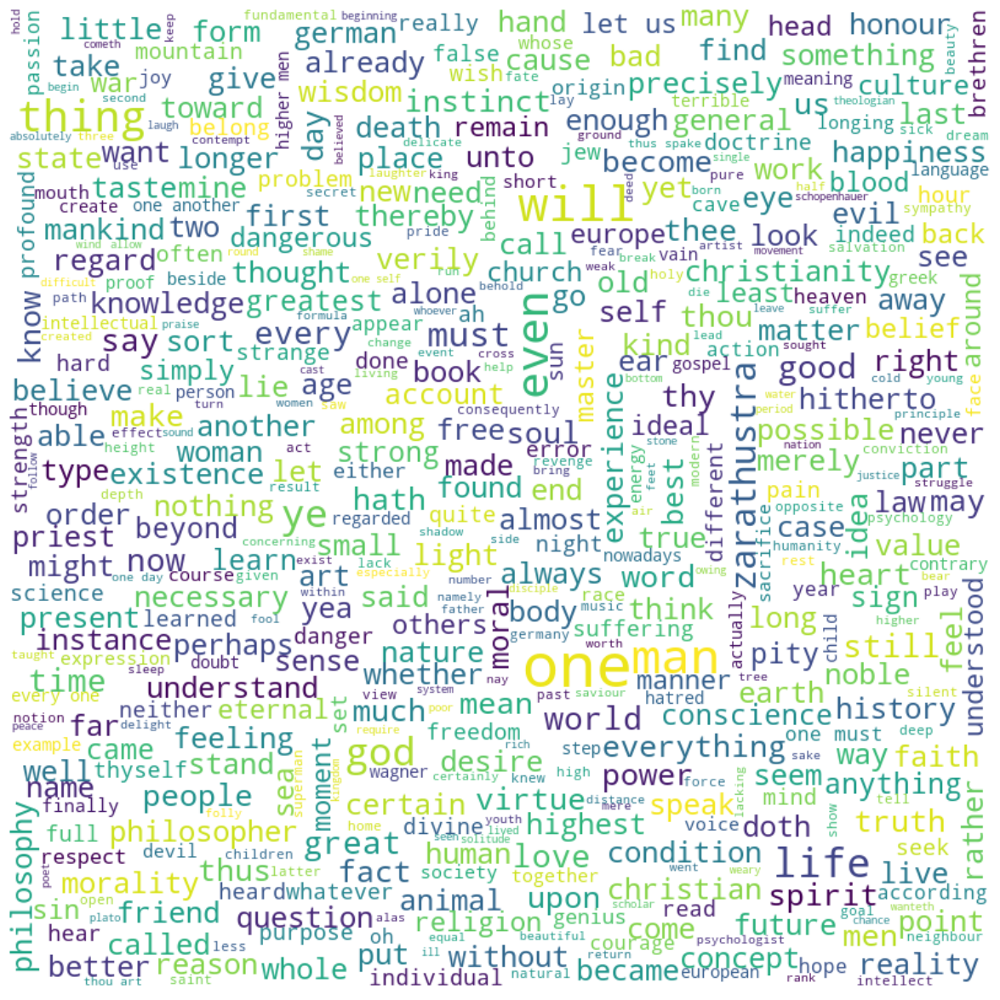

School =  FEMINISM :


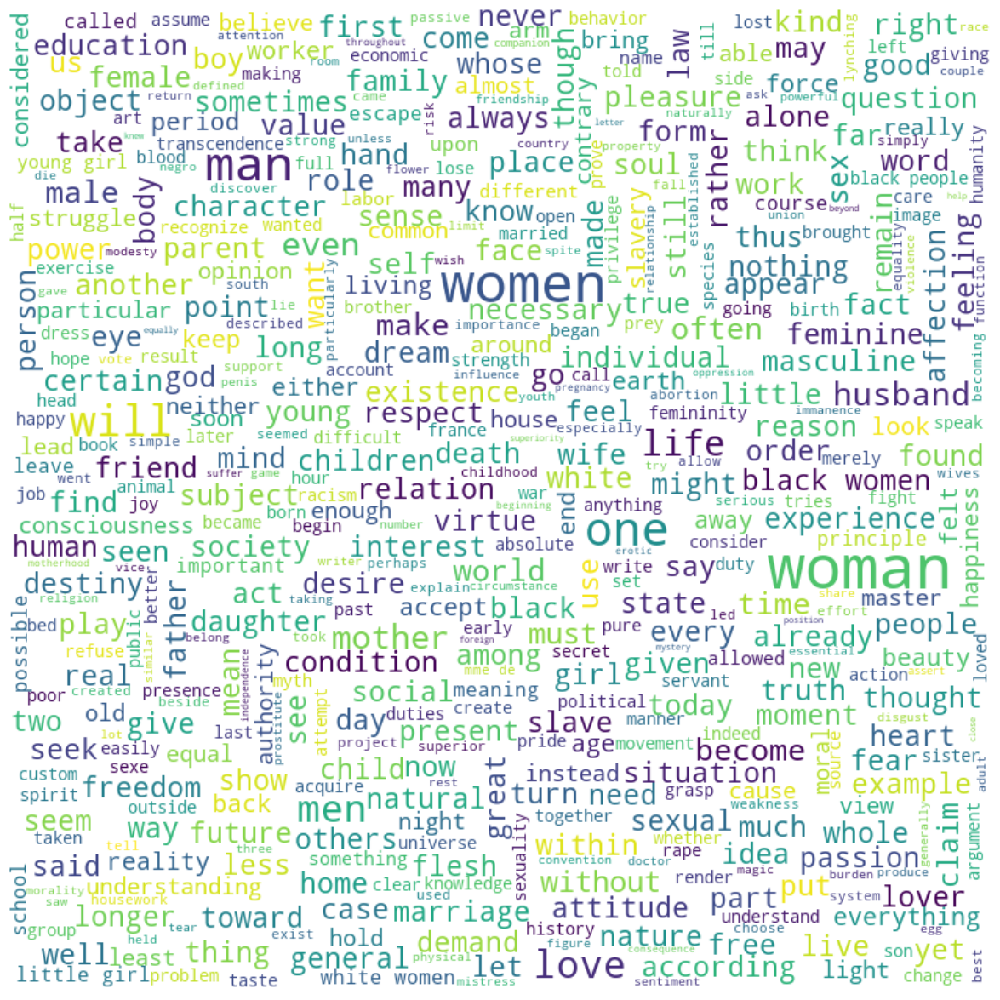

Elapsed time:  39.02


In [257]:
from wordcloud import WordCloud, STOPWORDS

schools = df.school.unique()

t1 = time.time()
for i in schools:
    df_temp = df[df.school == i]
    print('School = ', i.upper(), ':')
    
    text = " ".join(txt for txt in df_temp.sentence_lowered)
    wordcloud = WordCloud(width = 800, height = 800, 
                          max_font_size = 50,
                          max_words= 500,
                          background_color='white',
                          stopwords = STOPWORDS).generate(text)
    plt.figure(figsize=(15,15))
    plt.imshow(wordcloud, interpolation='bilinear')
    plt.axis("off")
    plt.show()
t2 = time.time()
print('Elapsed time: ', np.round(t2-t1, 2))


In [264]:
# to build a model that finding synonyms based on what philosophers said
import h2o
from h2o.estimators import H2OWord2vecEstimator, H2OGradientBoostingEstimator

h2o.init()

Checking whether there is an H2O instance running at http://localhost:54321 . connected.


H2O_cluster_uptime:,15 mins 46 secs
H2O_cluster_timezone:,America/New_York
H2O_data_parsing_timezone:,UTC
H2O_cluster_version:,3.38.0.4
H2O_cluster_version_age:,23 days
H2O_cluster_name:,H2O_from_python_wanghan_662vpz
H2O_cluster_total_nodes:,1
H2O_cluster_free_memory:,3.265 Gb
H2O_cluster_total_cores:,8
H2O_cluster_allowed_cores:,8
H2O_cluster_status:,"locked, healthy"


In [265]:
text_h2o = h2o.H2OFrame(df[['school', 'sentence_lowered']])

def tokenize(sentences, stop_word = STOPWORDS): 
    tokenized = sentences.tokenize("\\W+")
    tokenized_lower = tokenized.tolower()
    tokenized_filtered = tokenized_lower[(tokenized_lower.nchar() >= 2) | (tokenized_lower.isna()),:]
    tokenized_words = tokenized_filtered[tokenized_filtered.grep("[0-9]",invert=True,output_logical=True),:]
    tokenized_words = tokenized_words[(tokenized_words.isna()) | (~ tokenized_words.isin(stop_word)),:]
    return tokenized_words

Parse progress: |████████████████████████████████████████████████████████████████| (done) 100%


In [272]:
words = tokenize(text_h2o['sentence_lowered'])

In [273]:
import random
random.seed(2023)

t1 = time.time()
w2v_model = H2OWord2vecEstimator(vec_size = 50,
                                 window_size = 5,
                                 sent_sample_rate = 0.001,
                                 init_learning_rate = 0.025,
                                 epochs = 10)
w2v_model.train(training_frame=words)
t2 = time.time()
print('Elapsed time:', np.round(t2-t1,2), 'secs')

word2vec Model Build progress: |█████████████████████████████████████████████████| (done) 100%
Elapsed time: 219.4 secs


In [274]:
w2v_model.find_synonyms('time', count =5)

OrderedDict([('elapsed', 0.7264862656593323),
             ('duration', 0.7249752283096313),
             ('always', 0.6882477402687073),
             ('day', 0.6641055345535278),
             ('interval', 0.6628923416137695)])

In [275]:
w2v_model.find_synonyms('food', count =5)

OrderedDict([('feed', 0.7981991171836853),
             ('drink', 0.7952733635902405),
             ('clothing', 0.7807243466377258),
             ('nourishment', 0.7559901475906372),
             ('foods', 0.7533254623413086)])